<a href="https://colab.research.google.com/github/nanda3-vit/BioInspiredAlgorithm/blob/master/Glowworm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

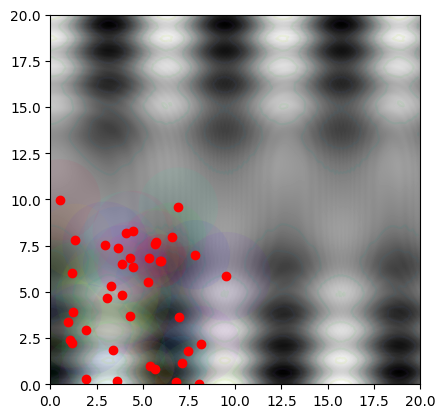

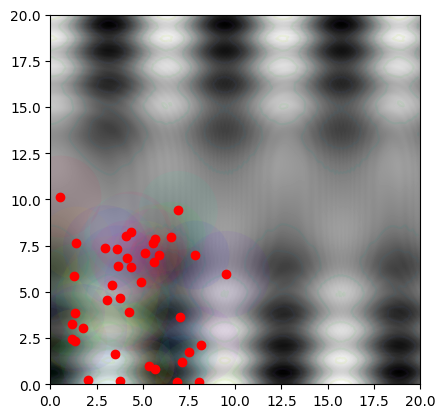

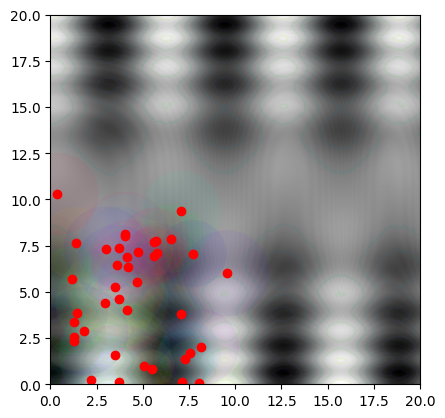

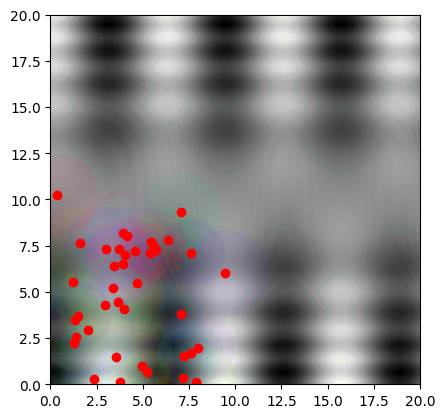

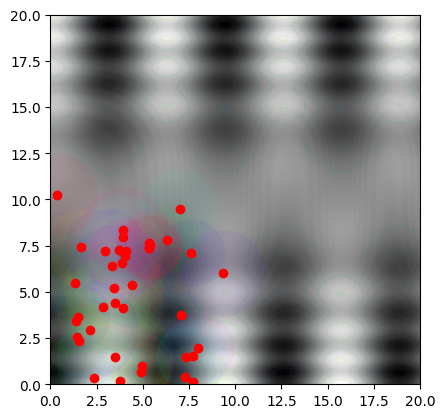

...

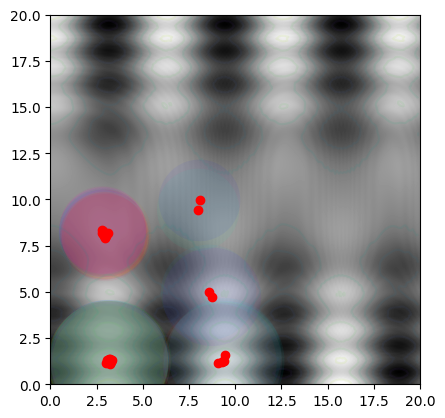

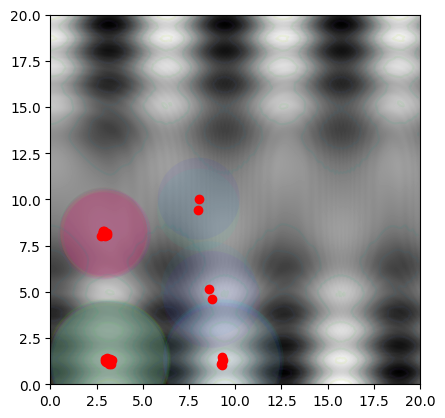

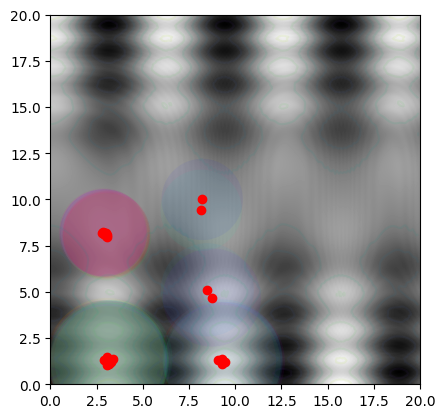

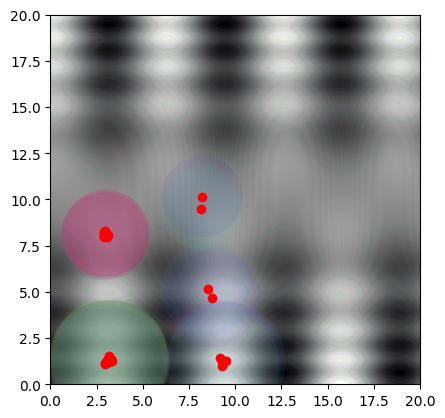

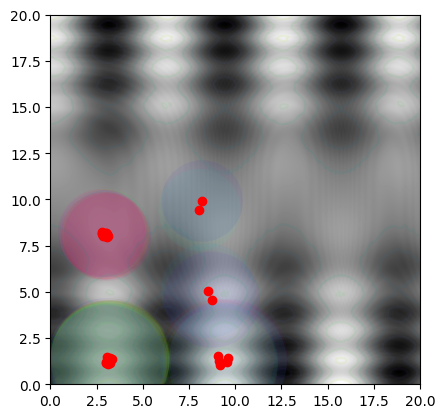

In [ ]:
import numpy as np
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.collections import PatchCollection
from scipy.spatial import distance as dist
import copy


# Since the fitness function rates some worms negatively, the lower bound exists
# to add to all of the scores so they are positive before normalization
# The influence factor is divided form all the positive scores to determine the
# range of influence.
dims = 20
num_worms = 40
nturns = 150
lower_bound = 100
influence_factor = 50
max_jitter = .2

def fitness_function(xy_tuple):
    x = xy_tuple[0]/2
    y = xy_tuple[1]/2
    return np.sin(x**3+ (y-5)**3) + np.cos((y-5)**2) *10 + np.cos(x*2) * 12 * (y-5)

def starting_points():
    return np.random.rand(num_worms,2) * 10
    
def get_score(pop):
    temp = [ (fitness_function(tup)) for tup in pop ]
    normal = [ x + lower_bound for x in temp ]
    return [ x / influence_factor for x in normal ]

# This returns a matrix with the distances between each worm calculated if the
# worm in the row is influenced by the worm in the column, else 0
def influence_matrix(pop, score):
    graph = np.array([np.zeros(num_worms)] * num_worms)
    
    for i in range(num_worms):
        for j in range(num_worms):
            if i == j:
                graph[i][j] = 0
            elif dist.euclidean(pop[i], pop[j]) <= score[j]:
                graph[i][j] = dist.euclidean(pop[i], pop[j])
            else:
                continue
    return graph
    
def next_turn(pop, score, im):
    n_turn = copy.deepcopy(pop)
    
    # X and Y movement is determined by the ratio of distance between worms and
    # the radius of the influencing worm
    # This ensures that closer worms will have more influence than further worms
    # with the same pull, and at the same time worms with large influences will
    # have more pull than other worms of the same distance
    for i in range(num_worms):
        x_move = 0
        y_move = 0
        for j in range(num_worms):
            percent_move = 1 - (im[i][j] / score[j]) if im[i][j] != 0 else 0
            x_move += (pop[j][0] - pop[i][0]) * percent_move / 10 if score[i] < score[j] else 0
            y_move += (pop[j][1] - pop[i][1]) * percent_move / 10 if score[i] < score[j] else 0
        jitter_x = max_jitter * np.random.rand() * np.random.randint(-1,2)
        jitter_y = max_jitter * np.random.rand() * np.random.randint(-1,2)
        n_turn[i][0] += x_move + jitter_x
        n_turn[i][1] += y_move + jitter_y
        
        n_turn[i][0] = keep_in_bounds(n_turn[i][0], dims)
        n_turn[i][1] = keep_in_bounds(n_turn[i][1], dims)
        
    return n_turn
        
def keep_in_bounds(x,dims):
    if x < 0:
        return 0
    elif x > dims:
        return dims
    else:
        return x

    
### START ###
pop = starting_points()
for each in range(nturns):
    score = get_score(pop)
    
    
    ### PLOT ###
    plt.rcdefaults()
    fig, ax = plt.subplots()
    
    x = np.arange(0, dims, 0.1)
    y = np.arange(0, dims, 0.1)
    xx, yy = np.meshgrid(x, y, sparse=True)
    z = fitness_function([xx, yy])
    im = plt.imshow(z, interpolation='bilinear', origin='lower', cmap=cm.gray, extent=(0, dims, 0, dims ))
    plt.contour(x,y,z,alpha=0.1)
    
    plt.plot(pop[:,0], pop[:,1], 'ro' )
    
    ### UNCOMMENT THE FOLLOWING TO SEE WORMS INFLUENCE ###
    patches = []
    for i in range(0,num_worms):    
        patches.append( mpatches.Circle((pop[i][0],pop[i][1]), score[i], ec = "none") )
  
    colors = np.linspace(0, 1, len(patches))
    collection = PatchCollection(patches, cmap=plt.cm.hsv, alpha=0.05)
    collection.set_array(np.array(colors))
    ax.add_collection(collection)
    #####
    
    plt.show()
    print()
    name = "0000000" + str(each)
    name = name[-4:] + '.png'
    plt.savefig(name, bbox_inches='tight')

    im = influence_matrix(pop,score)
    pop = copy.deepcopy(next_turn(pop,score,im))
    plt.close("all")